# Udacity Self-Driving Car- Advanced Lane Finding Project

--------------------------------------------------
### The goals/steps fo the project
- Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
- Apply a distortion correction to raw images.
- Use color transforms, gradients, etc., to create a thresholded binary image.
- Apply a perspective transform to rectify binary image ("birds-eye view").
- Detect lane pixels and fit to find the lane boundary.
- Determine the curvature of the lane and vehicle position on center.
- Warp the detected lane boundaries back onto the original image.
- Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

## Import Required Libraries

In [1]:
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle 
import glob
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [2]:
cam_cal = 'camera_cal'
cam_cal_img = glob.glob('./camera_cal/c*.jpg')
ca_imgs = len(cam_cal_img)
print('Length of Images for camera calibration: ', ca_imgs)
# print(cam_cal_img)

Length of Images for camera calibration:  20


## Camera Calibration
Images produced by cameras have distortion problems. Thus, we must calibrate images to measure distances correctly between features in the images. Corner points are found and stored in an array, imgpoints for each image using 'cv2.findChessboardCorners' function. Since chessboard is flat, we consider that z-coordinate is zero. We can undistort images using cv2.undistort function.

### Read and Display Original Images

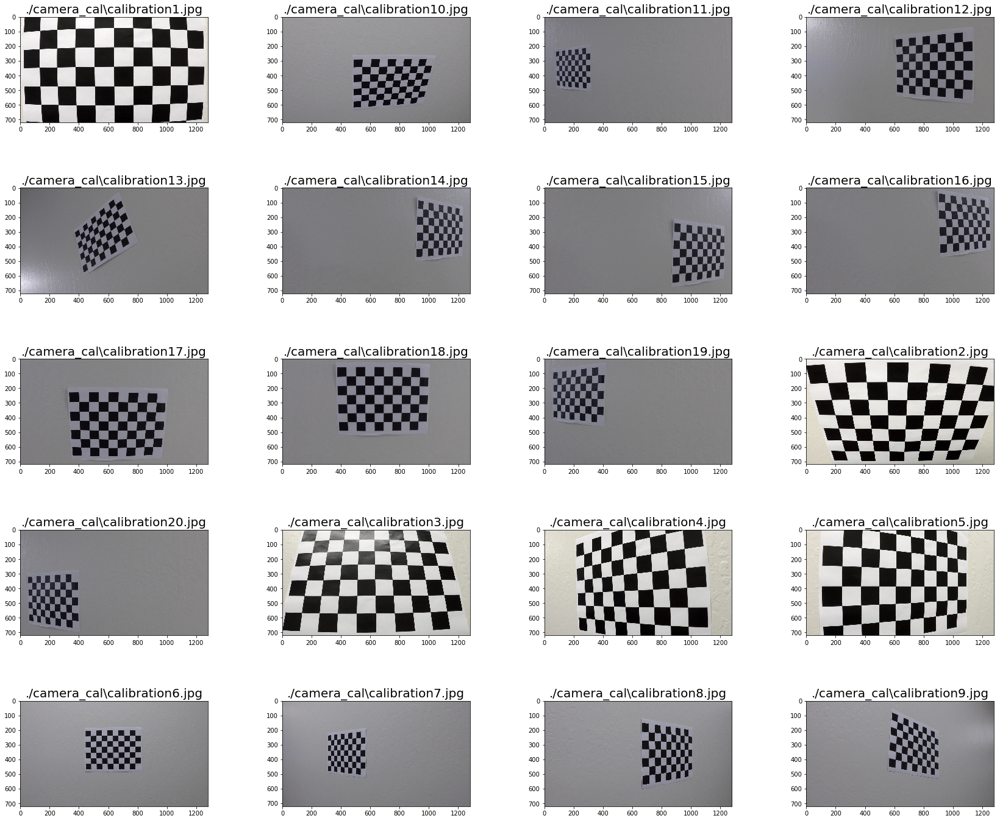

In [3]:
f, axs = plt.subplots(5, 4, figsize=(24, 9))
axs = axs.ravel()
# axs = axs.flatten()
for i, img in enumerate(cam_cal_img):
    img = mpimg.imread(img)
    f.tight_layout()
    axs[i].set_title(cam_cal_img[i], fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)
    axs[i].imshow(img)
plt.show()

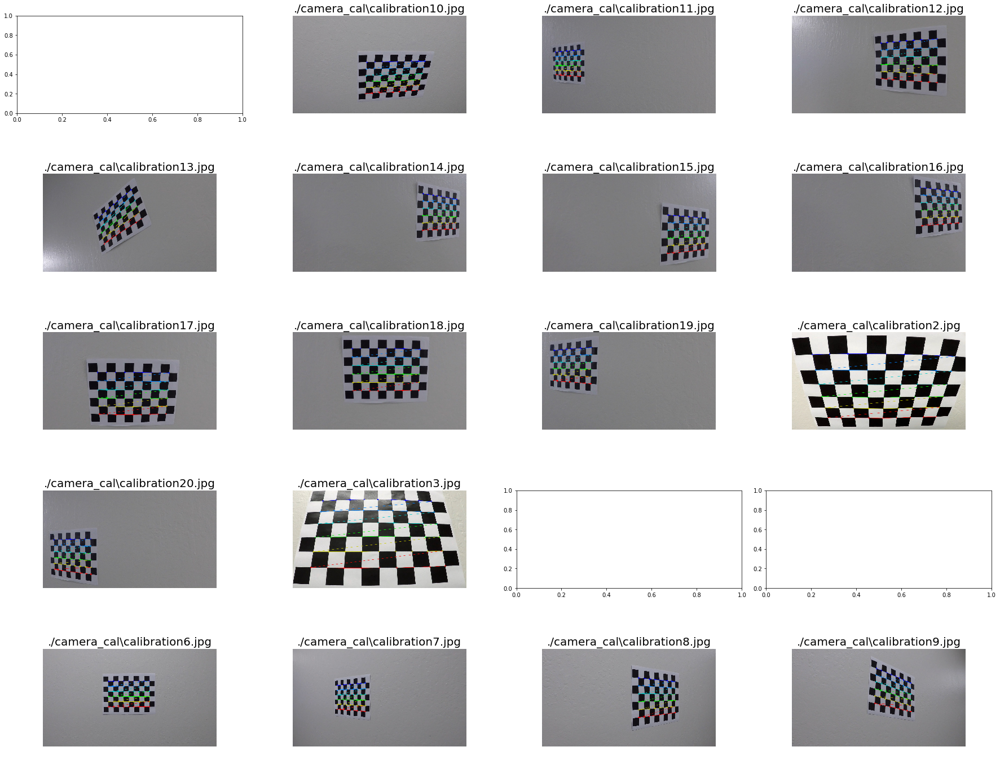

In [4]:
# http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_calib3d/py_calibration/py_calibration.html
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(9,6,0)
objp = np.zeros((9*6,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3-D point in real world
imgpoints = [] # 2-D points in image plane

# termination criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

f, axs = plt.subplots(5, 4, figsize=(24, 9))
axs = axs.ravel()

for i, fname in enumerate(cam_cal_img):
    img = mpimg.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Find the chess board corners
    ret, corners = cv2.findChessboardCorners(gray, (9, 6), None)
    
    # If found, add object points, image points (after refining them)
    if ret == True:
        objpoints.append(objp)
        # The value of (-1,-1) indicates that there is no such a size.
        corners2 = cv2.cornerSubPix(gray, corners, (11,11), (-1,-1), criteria)
        imgpoints.append(corners)
        
        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9, 6), corners2, ret)
        f.tight_layout()
        axs[i].axis('off')
        axs[i].set_title(cam_cal_img[i], fontsize=20)
        plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)
        axs[i].imshow(img)
plt.show()       

- Some images do not appear to have the specified number of chessboard corners. 

## Test Undistortion of an Image

In [5]:
img = mpimg.imread('./camera_cal/calibration1.jpg')
img_size = (img.shape[1], img.shape[0])

""" 
For that we use the function, cv2.calibrateCamera(). 
It returns the camera matrix, distortion coefficients, 
rotation and translation vectors etc. 
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
"""

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
dst = cv2.undistort(img, mtx, dist, None, mtx)

dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]
pickle.dump(dist_pickle, open("./camera_cal/calibration.p", "wb"))
dist_pickle = pickle.load(open('./camera_cal/calibration.p', 'rb'))
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]

In [6]:
nx = 9 # the number of inside corners in x
ny = 5 # the number of inside corners in y
def corners_unwarp(img, nx=nx, ny=ny, mtx=mtx, dist=dist):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    gray = cv2.cvtColor(undist, cv2.COLOR_RGB2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    img_size = (gray.shape[1], gray.shape[0])
    if ret == True:
        cv2.drawChessboardCorners(undist, (nx, ny), corners, ret)
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        offset = 100
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], [img_size[0]-offset, img_size[1]-offset], [offset, img_size[1]-offset]])
        M = cv2.getPerspectiveTransform(src, dst)
        warped = cv2.warpPerspective(undist, M, img_size, flags=cv2.INTER_LINEAR)
    return warped, M

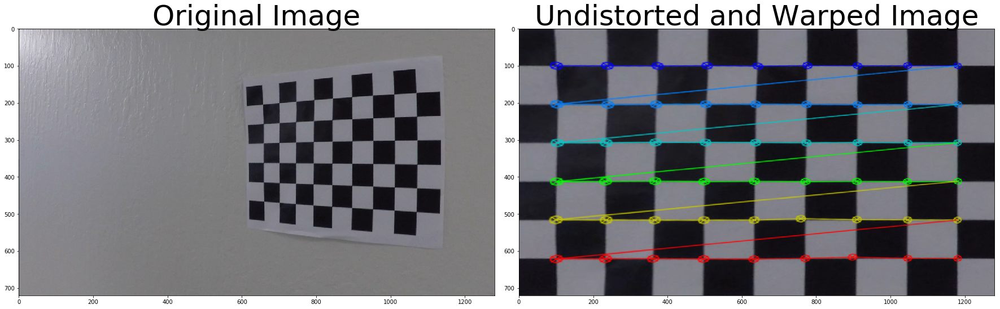

In [7]:
nx = 9 # the number of inside corners in x
ny = 6 # the number of inside corners in y
# img = mpimg.imread(cam_cal_img)
img = mpimg.imread('./camera_cal/calibration12.jpg')
top_down, perspective_M = corners_unwarp(img, nx, ny, mtx, dist)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(top_down)
ax2.set_title('Undistorted and Warped Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

- Pictures above are corrected using cv2.undistort function.

### Pipeline

#### Undistorting Images

In [8]:
def undistort(img):
    mtx = dist_pickle['mtx']
    dist = dist_pickle['dist']
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

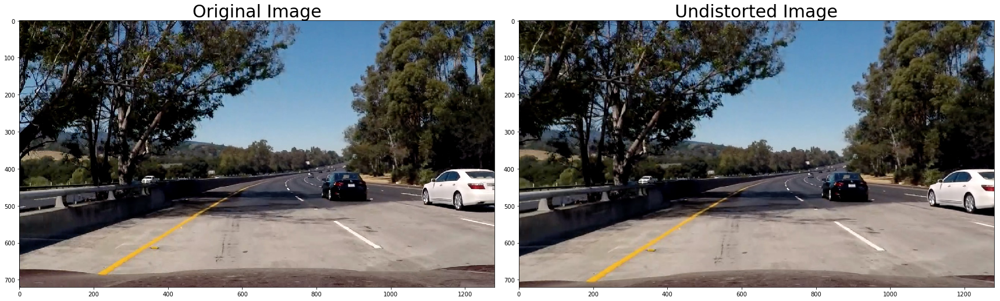

In [9]:
img = mpimg.imread('./test_images/test5.jpg')
f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
axs1.imshow(img)
axs1.set_title('Original Image', fontsize=30)
und_img = undistort(img)
axs2.imshow(und_img)
axs2.set_title('Undistorted Image', fontsize=30)
    
plt.show()

- This is an example of the undistorted image

#### Color and Gradient Threshold to Create the Best Edge Detection:
We want to detect well the lane lines on the road. To do that we, use combinations of color and gradient thresholds to filter out what we do not want. 

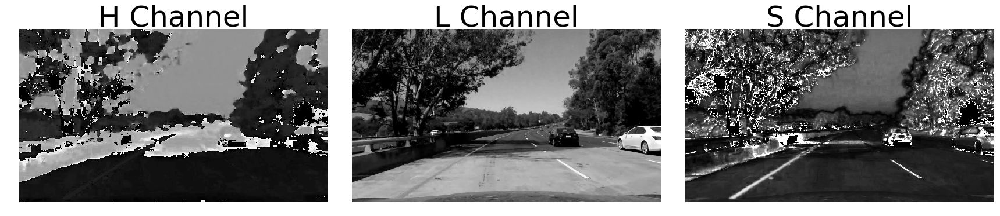

In [10]:
image = mpimg.imread('./test_images/test5.jpg')
und_img = undistort(img)
hls = cv2.cvtColor(und_img, cv2.COLOR_RGB2HLS)
H = hls[:,:,0]
L = hls[:,:,1]
S = hls[:,:,2]
f, (axs1, axs2, axs3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
axs1.set_title('H Channel', fontsize=50)
axs1.axis('off')
axs1.imshow(H, cmap='gray')
axs2.set_title('L Channel', fontsize=50)
axs2.axis('off')
axs2.imshow(L, cmap='gray')
axs3.set_title('S Channel', fontsize=50)
axs3.axis('off')
axs3.imshow(S, cmap='gray')
plt.show()

- Display H, L, S channel images to figure out which channel gives better result to detect the lanes. 
- S channel gives the best result showing lanes clearly. 

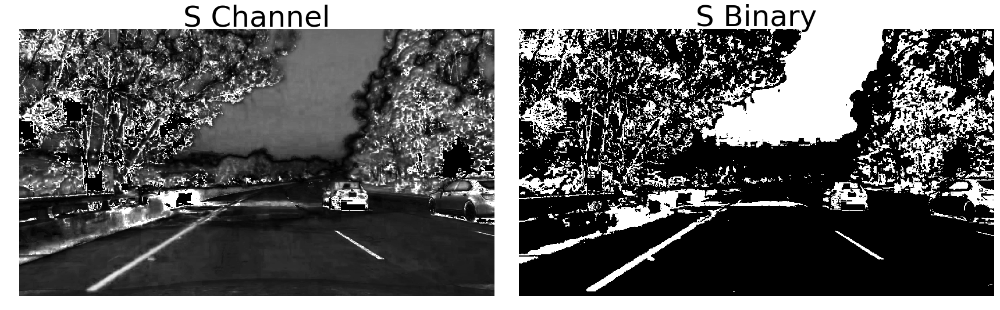

In [11]:
thresh = (90, 255)
binary = np.zeros_like(S)
binary[(S > thresh[0]) & (S <= thresh[1])] = 1
f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
axs1.set_title('S Channel', fontsize = 50)
axs1.axis('off')
axs1.imshow(S, cmap='gray')
axs2.set_title('S Binary', fontsize = 50)
axs2.axis('off')
axs2.imshow(binary, cmap='gray')
plt.show()

- Binary image of S channel

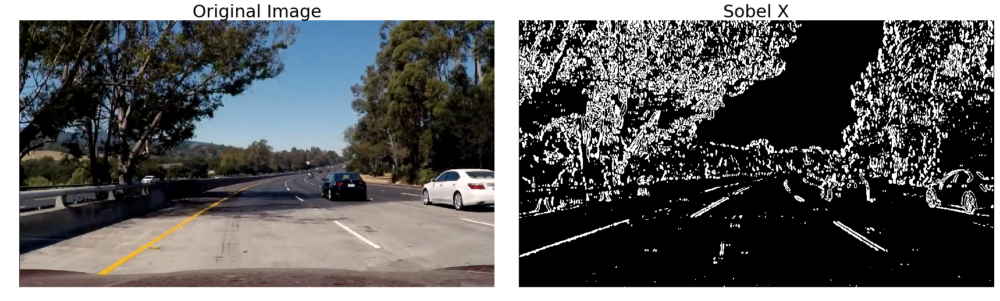

In [12]:
def abs_sobel(img, orient='x', sobel_kernel = 3, thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient =='y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))

    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return binary_output

# test_imgs = glob.glob('./test_images/t*.jpg')
ksize = 15

# for i, img in enumerate(test_imgs):
#     f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
#     img = mpimg.imread(img)
#     f.tight_layout()
#     axs1.axis('off')
#     axs1.set_title('Original Image', fontsize=30)
#     axs1.imshow(img, cmap='gray')
#     und_img = undistort(img)
#     sobel_x = abs_sobel(und_img, orient = 'x', sobel_kernel=ksize, thresh=(20, 100))
#     axs2.axis('off')
#     axs2.set_title('Sobel X', fontsize=30)
#     axs2.imshow(sobel_x, cmap='gray')
#     plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)

f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
img = mpimg.imread('./test_images/test5.jpg')
f.tight_layout()
axs1.axis('off')
axs1.set_title('Original Image', fontsize=30)
axs1.imshow(img, cmap='gray')
und_img = undistort(img)
sobel_x = abs_sobel(und_img, orient = 'x', sobel_kernel=ksize, thresh=(20, 100))
axs2.axis('off')
axs2.set_title('Sobel X', fontsize=30)
axs2.imshow(sobel_x, cmap='gray')
plt.show()

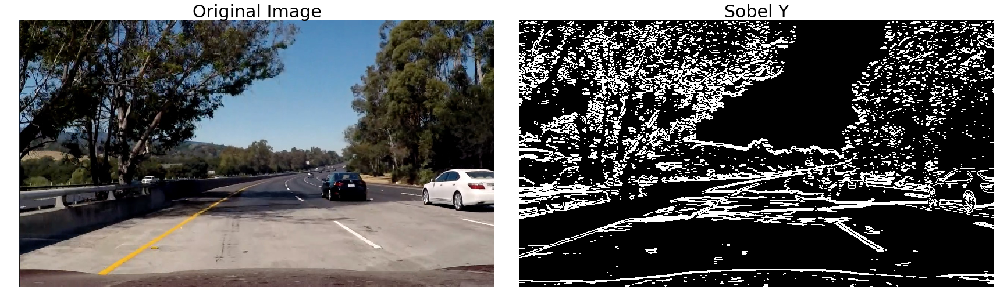

In [13]:
# for i, img in enumerate(test_imgs):
#     f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
#     img = mpimg.imread(img)
#     f.tight_layout()
#     axs1.axis('off')
#     axs1.set_title('Original Image', fontsize=30)
#     axs1.imshow(img, cmap='gray')
#     und_img = undistort(img)
#     sobel_y = abs_sobel(und_img, orient = 'y', sobel_kernel=ksize, thresh=(20, 100))
#     axs2.axis('off')
#     axs2.set_title('Sobel Y', fontsize=30)
#     axs2.imshow(sobel_y, cmap='gray')
#     plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)

# plt.show()
f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
img = mpimg.imread('./test_images/test5.jpg')
f.tight_layout()
axs1.axis('off')
axs1.set_title('Original Image', fontsize=30)
axs1.imshow(img, cmap='gray')
und_img = undistort(img)
sobel_y = abs_sobel(und_img, orient = 'y', sobel_kernel=ksize, thresh=(20, 100))
axs2.axis('off')
axs2.set_title('Sobel Y', fontsize=30)
axs2.imshow(sobel_y, cmap='gray')
plt.show()

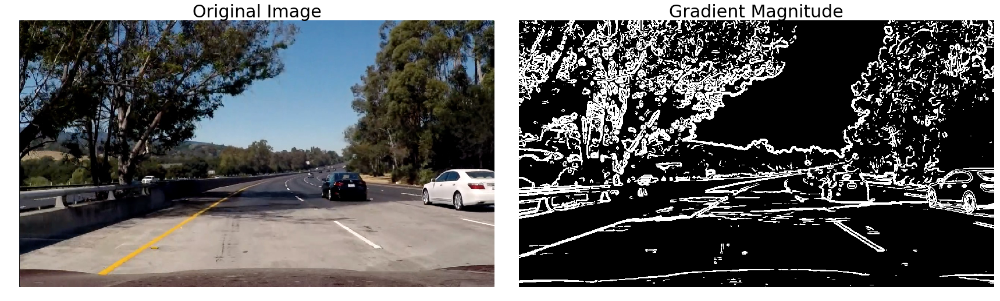

In [14]:
def gradient_magnitude(img, sobel_kernel=ksize, mag_thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    mag_sobel = np.sqrt(sobelx**2 + sobely**2) 
    scaled_sobel = np.uint8(255*mag_sobel/np.max(mag_sobel))
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
    return binary_output


# for i, img in enumerate(test_imgs):
#     f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
#     img = mpimg.imread(img)
#     f.tight_layout()
#     axs1.axis('off')
#     axs1.set_title('Original Image', fontsize=30)
#     axs1.imshow(img, cmap='gray')
#     und_img = undistort(img)
#     mag_binary = gradient_magnitude(und_img, sobel_kernel=ksize, mag_thresh=(30, 150))
#     axs2.axis('off')
#     axs2.set_title('Gradient Magnitude', fontsize=30)
#     axs2.imshow(mag_binary, cmap='gray')
#     plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)
f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
axs1.axis('off')
axs1.set_title('Original Image', fontsize=30)
axs1.imshow(img, cmap='gray')
und_img = undistort(img)
mag_binary = gradient_magnitude(und_img, sobel_kernel=ksize, mag_thresh=(30, 150))
axs2.axis('off')
axs2.set_title('Gradient Magnitude', fontsize=30)
axs2.imshow(mag_binary, cmap='gray')
plt.show()

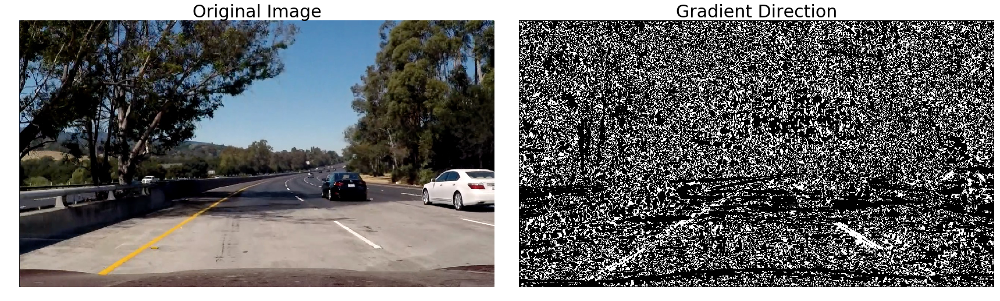

In [15]:
def gradient_direction(img, sobel_kernel=ksize, thresh=(0, np.pi/2)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    abs_sobelx = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    abs_sobely = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    gradient_dir = np.arctan2(abs_sobely, abs_sobelx)
    binary_output = np.zeros_like(gradient_dir)
    binary_output[(gradient_dir >= thresh[0]) & (gradient_dir <= thresh[1])] = 1
    return binary_output

# for i, img in enumerate(test_imgs):
#     f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
#     img = mpimg.imread(img)
#     f.tight_layout()
#     axs1.axis('off')
#     axs1.set_title('Original Image', fontsize=30)
#     axs1.imshow(img, cmap='gray')
#     und_img = undistort(img)
#     gra_dir = gradient_direction(und_img, sobel_kernel=ksize, thresh=(0.7, 1.2))
#     axs2.axis('off')
#     axs2.set_title('Gradient Direction', fontsize=30)
#     axs2.imshow(gra_dir, cmap='gray')
#     plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)

f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
axs1.axis('off')
axs1.set_title('Original Image', fontsize=30)
axs1.imshow(img, cmap='gray')
und_img = undistort(img)
gra_dir = gradient_direction(und_img, sobel_kernel=ksize, thresh=(0.7, 1.2))
axs2.axis('off')
axs2.set_title('Gradient Direction', fontsize=30)
axs2.imshow(gra_dir, cmap='gray')
plt.show()

In [16]:
def hls_select(img, thresh=(0, 255)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = hls[:,:,2]
    binary_output = np.zeros_like(S)
    binary_output[(S > thresh[0]) & (S <= thresh[1])] = 1
    return binary_output

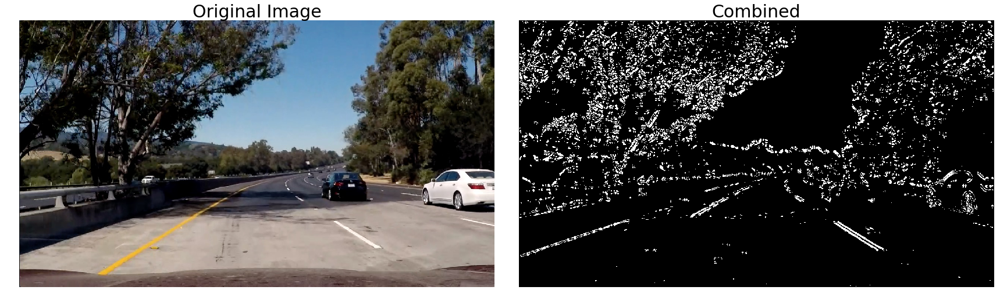

In [17]:
def pipeline_1(img):
    sobel_x = abs_sobel(img, orient = 'x', sobel_kernel=ksize, thresh=(20, 100))
    sobel_y = abs_sobel(img, orient = 'y', sobel_kernel=ksize, thresh=(20, 100))
    mag_binary = gradient_magnitude(img, sobel_kernel=ksize, mag_thresh=(30, 150))
    gra_dir = gradient_direction(img, sobel_kernel=ksize, thresh=(0.7, 1.2))
    combined = np.zeros_like(gra_dir)
    combined[((sobel_x == 1) & (sobel_y == 1)) | ((mag_binary == 1) & (gra_dir == 1))] = 1
    return combined

# for i, img in enumerate(test_imgs):
#     f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
#     img = mpimg.imread(img)
#     f.tight_layout()
#     axs1.axis('off')
#     axs1.set_title('Original Image', fontsize=30)
#     axs1.imshow(img, cmap='gray')
#     und_img = undistort(img)
#     combined = pipeline_1(und_img)
#     axs2.axis('off')
#     axs2.set_title('Combined', fontsize=30)
#     axs2.imshow(combined, cmap='gray')
#     plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)

f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
axs1.axis('off')
axs1.set_title('Original Image', fontsize=30)
axs1.imshow(img, cmap='gray')
und_img = undistort(img)
combined = pipeline_1(und_img)
axs2.axis('off')
axs2.set_title('Combined', fontsize=30)
axs2.imshow(combined, cmap='gray')
plt.show()

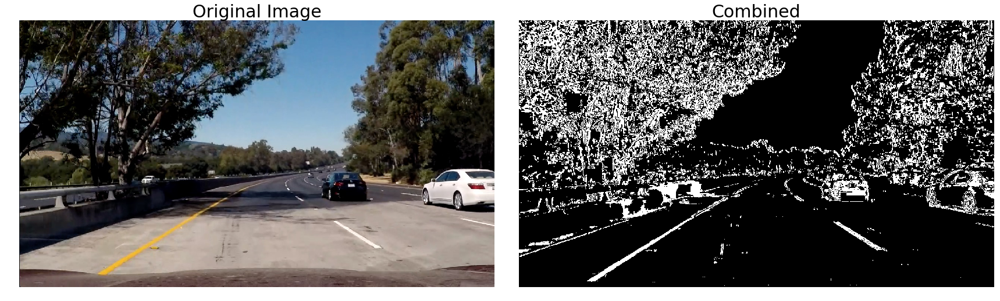

In [18]:
def pipeline_2(img, sobel_kernel=ksize, s_thresh=(170, 255), sx_thresh=(20, 100)):
# def pipeline_2(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    img = np.copy(img)
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0, ksize=sobel_kernel) # Take the derivative in x
#     sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
#     color_binary = np.dstack(( np.zeros_like(sxbinary, sxbinary, s_binary)) * 255
    color_binary = np.dstack((np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    return combined_binary





ksize = 5

# for i, img in enumerate(test_imgs):
#     f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
#     img = mpimg.imread(img)
#     f.tight_layout()
#     axs1.axis('off')
#     axs1.set_title('Original Image', fontsize=30)
#     axs1.imshow(img, cmap='gray')
#     und_img = undistort(img)
#     combined = pipeline_2(und_img, sobel_kernel=ksize, s_thresh=(160, 255), sx_thresh=(20, 100))
#     axs2.axis('off')
#     axs2.set_title('Combined', fontsize=30)
#     axs2.imshow(combined, cmap='gray')
#     plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)

f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
axs1.axis('off')
axs1.set_title('Original Image', fontsize=30)
axs1.imshow(img, cmap='gray')
und_img = undistort(img)
combined = pipeline_2(und_img, sobel_kernel=ksize, s_thresh=(160, 255), sx_thresh=(20, 100))
axs2.axis('off')
axs2.set_title('Combined', fontsize=30)
axs2.imshow(combined, cmap='gray')
plt.show()

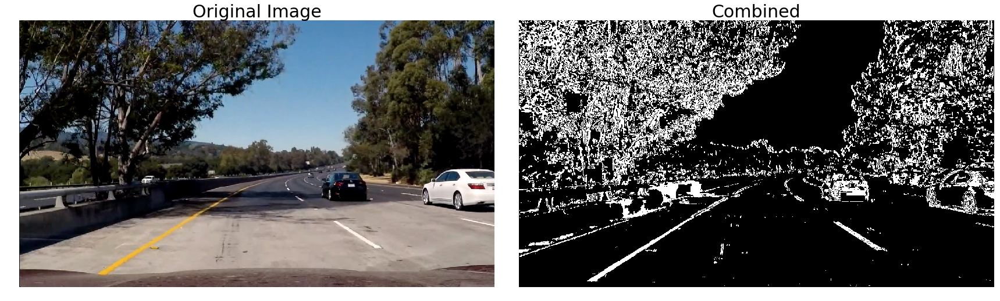

In [19]:
def pipeline_3(img, sobel_kernel=ksize, s_thresh=(170, 255), sx_thresh=(20, 100)):
# def pipeline_2(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    img = np.copy(img)
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Sobel y
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0, ksize=sobel_kernel) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
#     color_binary = np.dstack(( np.zeros_like(sxbinary, sxbinary, s_binary)) * 255
    mag_binary = gradient_magnitude(img, sobel_kernel=ksize, mag_thresh=(30, 150))
    gra_dir = gradient_direction(img, sobel_kernel=ksize, thresh=(0.7, 1.2))
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    combined_binary = np.zeros_like(sxbinary)
#     combined_binary[(s_binary == 1) | (sxbinary == 1) | (gra_dir == 1)] = 1
    combined_binary[(s_binary == 1) | (sxbinary == 1) | ((mag_binary == 1) & (gra_dir == 1))] = 1
    return combined_binary
                             
ksize = 5

# for i, img in enumerate(test_imgs):
#     f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
#     img = mpimg.imread(img)
#     f.tight_layout()
#     axs1.axis('off')
#     axs1.set_title('Original Image', fontsize=30)
#     axs1.imshow(img, cmap='gray')
#     und_img = undistort(img)
#     combined = pipeline_3(und_img, sobel_kernel=ksize, s_thresh=(160, 255), sx_thresh=(20, 100))
#     axs2.axis('off')
#     axs2.set_title('Combined', fontsize=30)
#     axs2.imshow(combined, cmap='gray')
#     plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)

f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
# img = mpimg.imread(img)
f.tight_layout()
axs1.axis('off')
axs1.set_title('Original Image', fontsize=30)
axs1.imshow(img, cmap='gray')
und_img = undistort(img)
combined = pipeline_3(und_img, sobel_kernel=ksize, s_thresh=(160, 255), sx_thresh=(20, 100))
axs2.axis('off')
axs2.set_title('Combined', fontsize=30)
axs2.imshow(combined, cmap='gray')
plt.show()

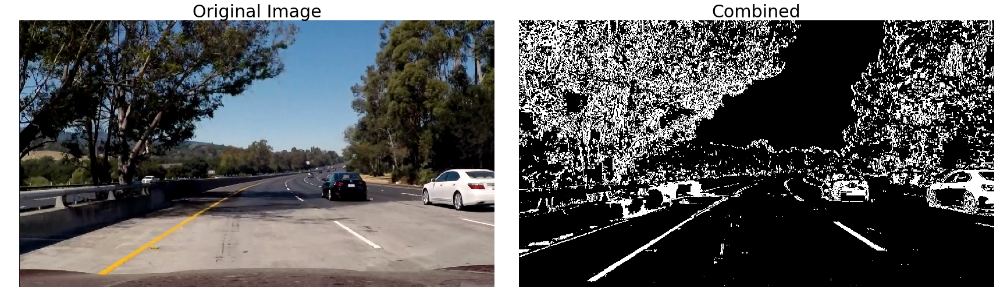

In [20]:
def pipeline_4(img, sobel_kernel=ksize, r_thresh=(225, 255), 
               s_thresh=(160, 255), sx_thresh=(20, 100)):
# def pipeline_2(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    img = np.copy(img)
    r_channel = img[:,:,1]
    r_binary = np.zeros_like(r_channel)
    r_binary[(r_channel >= r_thresh[0]) & (r_channel <= r_thresh[1])] = 1
    
#     g_channel = img[:,:,2]
#     g_binary = np.zeros_like(g_channel)
#     g_binary[(g_channel >= g_thresh[0]) & (g_channel <= g_thresh[1])] = 1
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0, ksize=sobel_kernel) # Take the derivative in x
#     sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
#     color_binary = np.dstack(( np.zeros_like(sxbinary, sxbinary, s_binary)) * 255
    color_binary = np.dstack((np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1) | (r_binary == 1)] = 1
    return combined_binary





ksize = 5

# for i, img in enumerate(test_imgs):
#     f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
#     img = mpimg.imread(img)
#     f.tight_layout()
#     axs1.axis('off')
#     axs1.set_title('Original Image', fontsize=30)
#     axs1.imshow(img, cmap='gray')
#     und_img = undistort(img)
#     combined = pipeline_4(und_img, sobel_kernel=ksize, r_thresh=(225, 255),
#                           s_thresh=(160, 255), sx_thresh=(20, 100))
#     axs2.axis('off')
#     axs2.set_title('Combined', fontsize=30)
#     axs2.imshow(combined, cmap='gray')
#     plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)

f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
# img = mpimg.imread(img)
f.tight_layout()
axs1.axis('off')
axs1.set_title('Original Image', fontsize=30)
axs1.imshow(img, cmap='gray')
und_img = undistort(img)
combined = pipeline_4(und_img, sobel_kernel=ksize, r_thresh=(225, 255),
                      s_thresh=(160, 255), sx_thresh=(20, 100))
axs2.axis('off')
axs2.set_title('Combined', fontsize=30)
axs2.imshow(combined, cmap='gray')
plt.show()

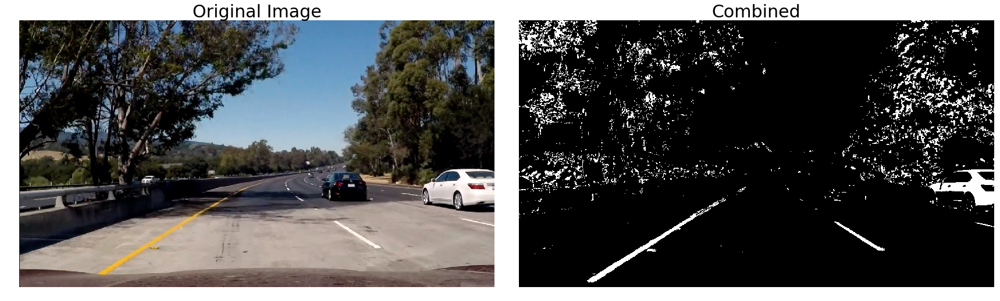

In [21]:
def pipeline_5(img, sobel_kernel=ksize, r_thresh=(225, 255), h_thresh = (15, 80),
               l_thresh = (120, 255), s_thresh=(160, 255)):
# def pipeline_2(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    img = np.copy(img)
    r_channel = img[:,:,1]
    r_binary = np.zeros_like(r_channel)
    r_binary[(r_channel >= r_thresh[0]) & (r_channel <= r_thresh[1])] = 1
    
#     g_channel = img[:,:,2]
#     g_binary = np.zeros_like(g_channel)
#     g_binary[(g_channel >= g_thresh[0]) & (g_channel <= g_thresh[1])] = 1
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Sobel x
#     sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0, ksize=sobel_kernel) # Take the derivative in x
# #     sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
#     abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
#     scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
#     # Threshold x gradient
#     sxbinary = np.zeros_like(scaled_sobel)
#     sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    sobel_x = abs_sobel(img, orient = 'x', sobel_kernel=ksize, thresh=(20, 200))
    mag_binary = gradient_magnitude(img, sobel_kernel=ksize, mag_thresh=(30, 200))
    gra_dir = gradient_direction(img, sobel_kernel=ksize, thresh=(0.7, 1.3))
    
    # Threshold color channel
    h_binary = np.zeros_like(h_channel)
    h_binary[(h_channel >= h_thresh[0]) & (h_channel <= h_thresh[1])] = 1
    
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh[0]) & (l_channel <= l_thresh[1])] = 1
    
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    xmg_binary = np.zeros_like(sobel_x)
    xmg_binary[(sobel_x == 1) | ((mag_binary == 1) & (gra_dir ==1))] = 1
    
    hsr_binary = np.zeros_like(s_channel)
    hsr_binary[((s_binary == 1) & (h_binary == 1)) | (r_binary == 1)] = 1
    
    xmghl_binary = np.zeros_like(sobel_x)
    xmghl_binary[((h_binary == 1) & (l_binary == 1) & (xmg_binary == 1))] = 1
    
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
#     color_binary = np.dstack(( np.zeros_like(sxbinary, sxbinary, s_binary)) * 255
    color_binary = np.dstack((np.zeros_like(sobel_x), sobel_x, s_binary)) * 255
    combined_binary = np.zeros_like(sobel_x)
    combined_binary[((hsr_binary == 1) | (xmghl_binary == 1))] = 1
    return combined_binary





ksize = 3

# for i, img in enumerate(test_imgs):
#     f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
#     img = mpimg.imread(img)
#     f.tight_layout()
#     axs1.axis('off')
#     axs1.set_title('Original Image', fontsize=30)
#     axs1.imshow(img, cmap='gray')
#     und_img = undistort(img)
#     combined = pipeline_5(und_img, sobel_kernel=ksize, r_thresh=(210, 255), h_thresh = (15, 80),
#                l_thresh = (80, 255), s_thresh=(130, 255))
#     axs2.axis('off')
#     axs2.set_title('Combined', fontsize=30)
#     axs2.imshow(combined, cmap='gray')
#     plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)

f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
axs1.axis('off')
axs1.set_title('Original Image', fontsize=30)
axs1.imshow(img, cmap='gray')
und_img = undistort(img)
combined = pipeline_5(und_img, sobel_kernel=ksize, r_thresh=(210, 255), h_thresh = (15, 80),
           l_thresh = (80, 255), s_thresh=(130, 255))
axs2.axis('off')
axs2.set_title('Combined', fontsize=30)
axs2.imshow(combined, cmap='gray')
plt.show()

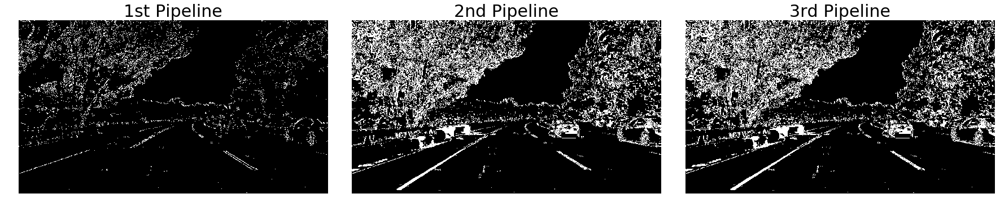

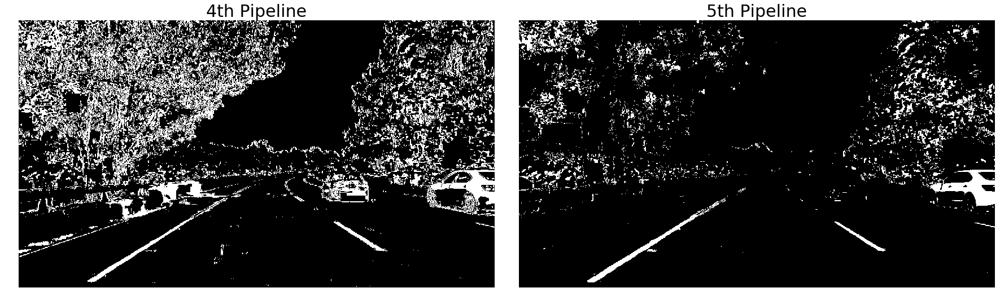

In [22]:
f, (axs1, axs2, axs3) = plt.subplots(1, 3, figsize=(24, 9))
img = mpimg.imread('./test_images/test5.jpg')
und_img = undistort(img)
pip_1 = pipeline_1(und_img)
pip_2 = pipeline_2(und_img, sobel_kernel=ksize, s_thresh=(160, 255), sx_thresh=(20, 100))
pip_3 = pipeline_3(und_img, sobel_kernel=ksize, s_thresh=(160, 255), sx_thresh=(20, 100))
f.tight_layout()
axs1.axis('off')
axs1.set_title('1st Pipeline', fontsize=30)
axs1.imshow(pip_1, cmap='gray')
und_img = undistort(img)
combined = pipeline_3(und_img, sobel_kernel=ksize, s_thresh=(160, 255), sx_thresh=(20, 100))
axs2.axis('off')
axs2.set_title('2nd Pipeline', fontsize=30)
axs2.imshow(pip_2, cmap='gray')
axs3.axis('off')
axs3.set_title('3rd Pipeline', fontsize=30)
axs3.imshow(pip_3, cmap='gray')
plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)
plt.show()

f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
img = mpimg.imread('./test_images/test5.jpg')
und_img = undistort(img)
pip_4 = pipeline_4(und_img, sobel_kernel=ksize, r_thresh=(225, 255),
                          s_thresh=(160, 255), sx_thresh=(20, 100))
pip_5 = pipeline_5(und_img, sobel_kernel=ksize, r_thresh=(210, 255), h_thresh = (15, 80),
               l_thresh = (80, 255), s_thresh=(130, 255))
f.tight_layout()
axs1.axis('off')
axs1.set_title('4th Pipeline', fontsize=30)
axs1.imshow(pip_4, cmap='gray')
axs2.axis('off')
axs2.set_title('5th Pipeline', fontsize=30)
axs2.imshow(pip_5, cmap='gray')
plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)
plt.show()

### Selection of the Pipeline:
After exploring several tries of combinations of , color channels, sobel, gradient, and thresholds, 5th one gives the best result to find out the lanes.
Images right above show which one gives the best result. At least in my case, magnitude and direction of the gradient do not quite help detect the lanes of the road. We can check out this from 'pipeline2' and 'pipeline3'. Red channel is added to avoid the detection of shadows acrossing the road. The better result is shown with 'pipeline5'.  

### Bird Eye View:
Perspective transform that let us view a lane from above is applied on the undistorted images. In normal view of the road, the lanes are seen as converging. We however need parallel structure of the lanes to get the exact lanes fro the car to drive. Four source points from the griginal images are selected on the lane part of the image and four destination points to form a rectangular are selected. To get the transformation and the warped image, cv2.getPerspectiveTransform() and cv2.warpPerspective() functions are used respectively. This is also useful to calculate the lane curvature.   

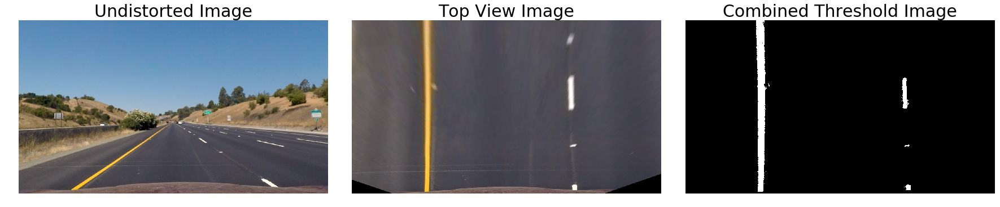

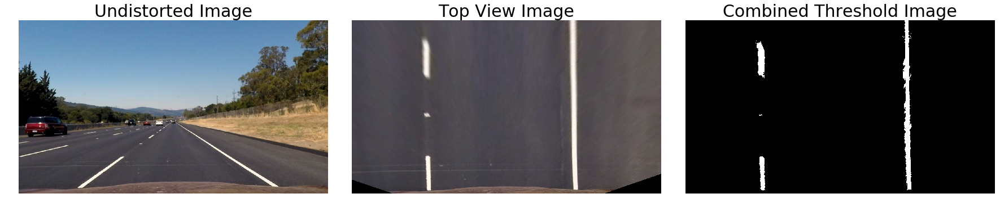

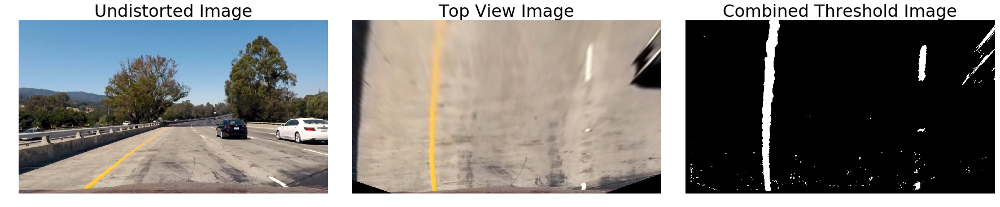

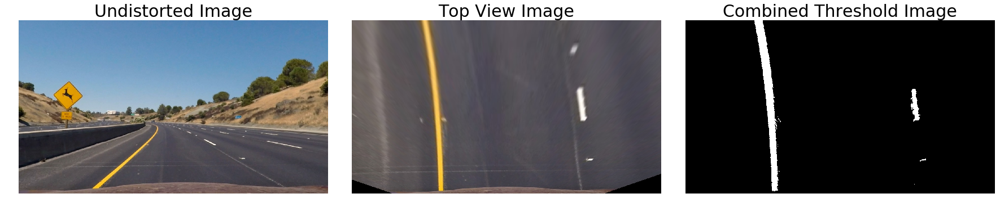

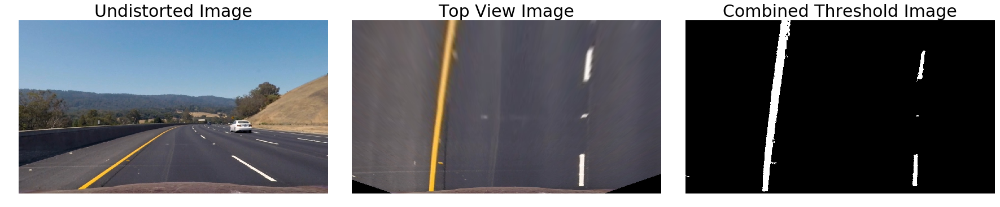

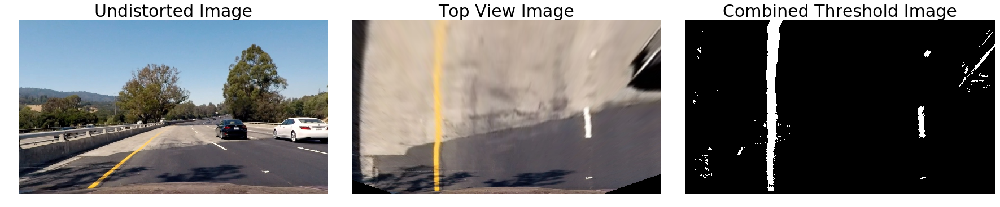

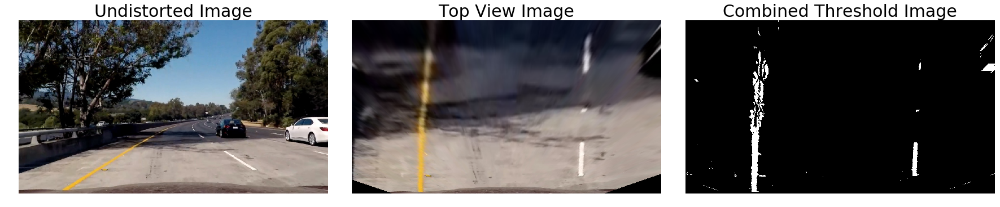

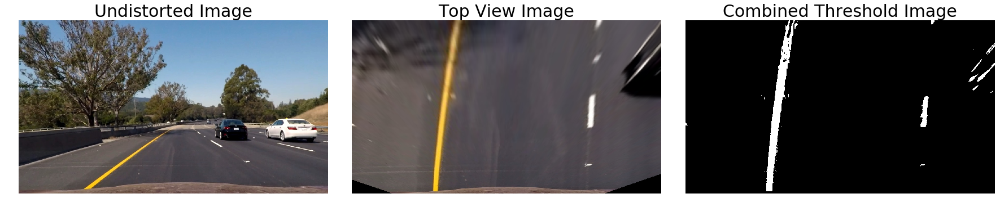

In [23]:
# Width: 1280
# Height: 720
def top_view(img):
    und_img = undistort(img)
    img_size = (und_img.shape[1], und_img.shape[0])

    src = np.float32(
        [[220, 720], 
         [1100, 720], 
         [570, 470], 
         [722, 470]])
    
    dst = np.float32(
        [[320, 720], 
         [920, 720], 
         [320, 0], 
         [920, 0]])
    
    # Compute the perspective transform, M
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # Warp an image using the perspective transform, M
    warped = cv2.warpPerspective(und_img, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warped, Minv

test_images = glob.glob('./test_images/*.jpg')
ksize = 3

for i, img in enumerate(test_images):
    f, (axs1, axs2, axs3) = plt.subplots(1, 3, figsize=(24, 9))
    img = mpimg.imread(img)
    und_img = undistort(img)
    bird_eye, _ = top_view(img)
#     pip_2 = pipeline_2(bird_eye, sobel_kernel=ksize, s_thresh=(150, 255), sx_thresh=(20, 100))
#     pip_3 = pipeline_3(bird_eye, sobel_kernel=ksize, s_thresh=(170, 255), sx_thresh=(20, 100))
#     pip_4 = pipeline_4(bird_eye, sobel_kernel=ksize, r_thresh=(225, 255), 
#                        s_thresh=(165, 255), sx_thresh=(20, 100))
    pip_5 = pipeline_5(bird_eye, sobel_kernel=ksize, r_thresh=(210, 255), h_thresh = (15, 80),
               l_thresh = (80, 255), s_thresh=(130, 255))
    und_topview_img = undistort(pip_2)
    f.tight_layout()
    axs1.axis('off')
    axs1.set_title('Undistorted Image', fontsize=30)
    axs1.imshow(und_img)
    axs2.axis('off')
    axs2.set_title('Top View Image', fontsize=30)
    axs2.imshow(bird_eye)
    axs3.axis('off')
    axs3.set_title('Combined Threshold Image', fontsize=30)
    axs3.imshow(pip_5, cmap='gray')
    plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)
    

plt.show() 

### Finding The Lanes
The detection of lanes is done using the sliding windows techique. The sum of the lane pixels in the combined binary thresholding images is taken for the bottom half of the image. In the histogram of the combined binary thresholding images, we can detect the two lane lines from the maximum values of two spikes. We slide the windows up, and repeat finding nonzero values from the bottom to the top of images. When the sliding window reaches the top of the combined binary thresholding image, the x and y values are extracted and a second-order polynomial is fit to these values.

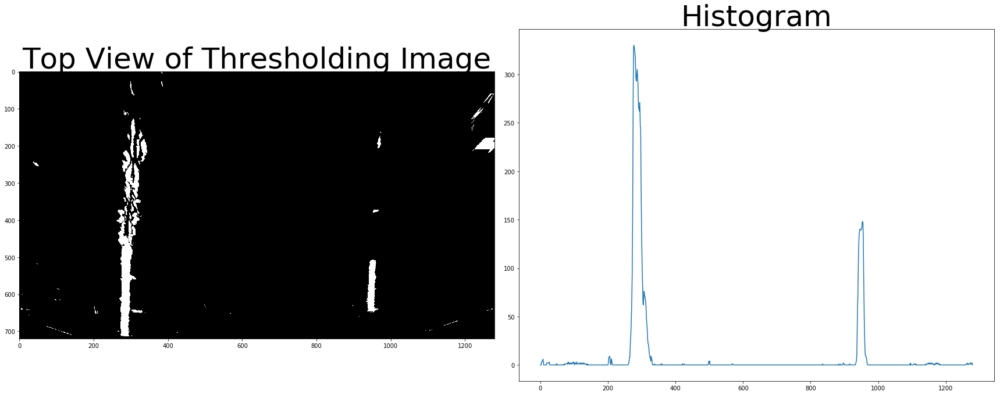

In [24]:
# Histogram
ksize = 3

# for i, img in enumerate(test_images):
#     f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
#     img = mpimg.imread(img)
#     bird_eye, _ = top_view(img)
#     combined_binary_warped = pipeline_5(bird_eye, sobel_kernel=ksize, r_thresh=(210, 255), h_thresh = (15, 80),
#                l_thresh = (80, 255), s_thresh=(130, 255))
#     histogram = np.sum(combined_binary_warped[combined_binary_warped.shape[0]//2:,:], axis=0)
#     f.tight_layout()
#     axs1.set_title('Top View of Thresholding Image', fontsize=30)
#     axs1.imshow(combined_binary_warped, cmap='gray')
#     axs2.set_title('Histogram', fontsize=30)
#     axs2.plot(histogram)
#     plt.subplots_adjust(left=0., right=1, top=.5, bottom=0.)

f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
img = mpimg.imread('./test_images/test5.jpg')
bird_eye, _ = top_view(img)
combined_binary_warped = pipeline_5(bird_eye, sobel_kernel=ksize, r_thresh=(210, 255), h_thresh = (15, 80),
           l_thresh = (80, 255), s_thresh=(130, 255))
histogram = np.sum(combined_binary_warped[combined_binary_warped.shape[0]//2:,:], axis=0)
f.tight_layout()
axs1.set_title('Top View of Thresholding Image', fontsize=50)
axs1.imshow(combined_binary_warped, cmap='gray')
axs2.set_title('Histogram', fontsize=50)
axs2.plot(histogram)

plt.show() 

Threre are two distinct spikes corresponding to the positions where lane lines are.

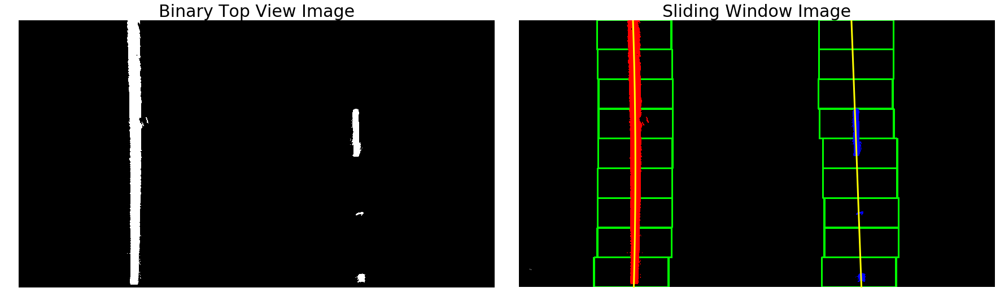

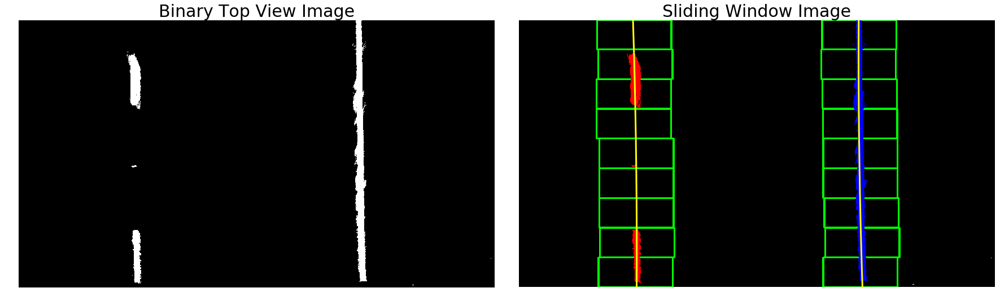

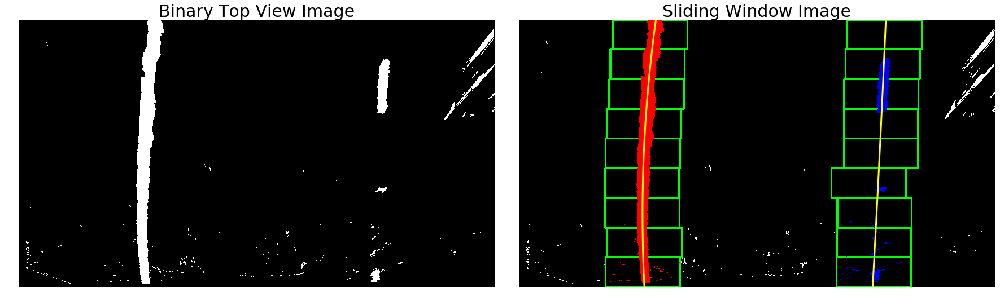

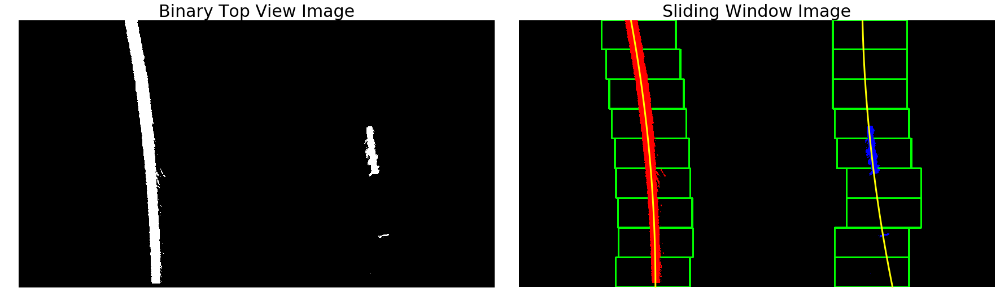

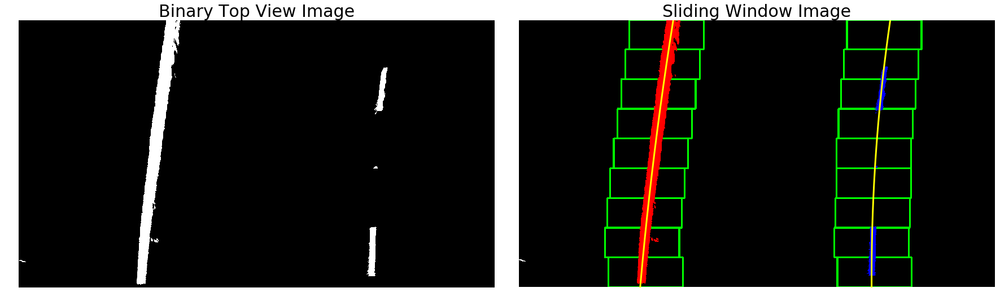

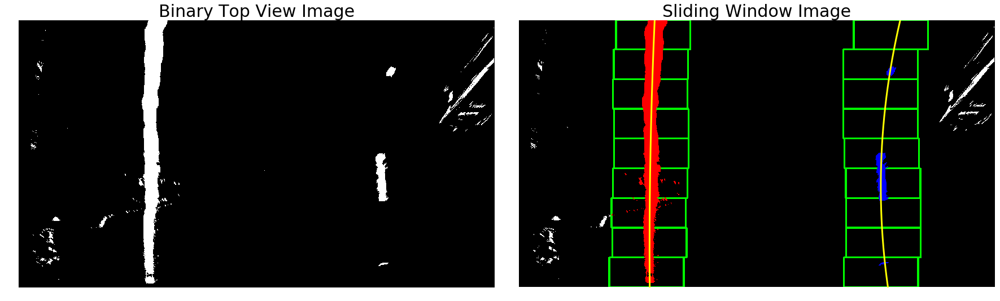

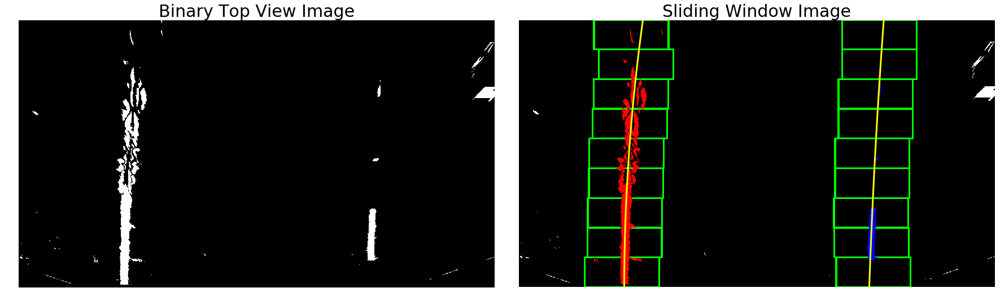

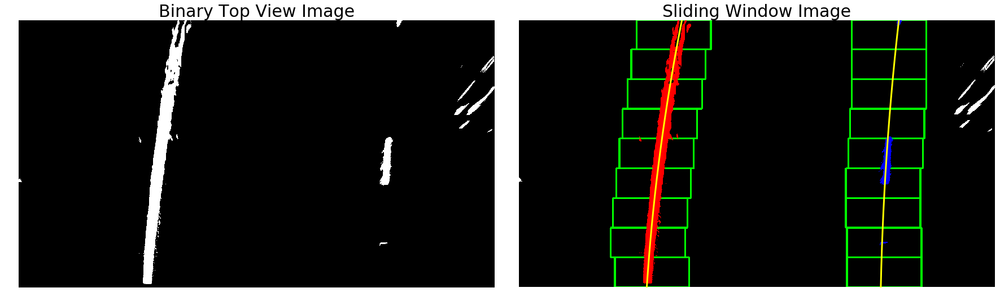

In [25]:
def sliding_windows(img):

    bird_eye, _ = top_view(img)

    combined_binary_warped = pipeline_5(bird_eye, sobel_kernel=ksize, r_thresh=(210, 255), h_thresh = (15, 80),
               l_thresh = (80, 255), s_thresh=(130, 255))
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(combined_binary_warped[combined_binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((combined_binary_warped, combined_binary_warped, combined_binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    # print('Mid Point: ', midpoint)
    # Mid Point:  640
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(combined_binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = combined_binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 5
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = combined_binary_warped.shape[0] - (window+1)*window_height
        win_y_high = combined_binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        # Need Top left coordinate, bottom right coordinate, color and line thickness
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 3) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 3) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, combined_binary_warped.shape[0]-1, combined_binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    return out_img, ploty, left_fitx, right_fitx, left_fit, right_fit

ksize = 3

for i, img in enumerate(test_images):
    f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
    img = mpimg.imread(img)
#     und_img = undistort(img)
    bird_eye, _ = top_view(img)
#     pip_2 = pipeline_2(bird_eye, sobel_kernel=ksize, s_thresh=(150, 255), sx_thresh=(20, 100))
#     pip_3 = pipeline_3(bird_eye, sobel_kernel=ksize, s_thresh=(170, 255), sx_thresh=(20, 100))
#     pip_4 = pipeline_4(bird_eye, sobel_kernel=ksize, r_thresh=(225, 255), 
#                        s_thresh=(165, 255), sx_thresh=(20, 100))
    pip_5 = pipeline_5(bird_eye, sobel_kernel=ksize, r_thresh=(210, 255), h_thresh = (15, 80),
               l_thresh = (80, 255), s_thresh=(130, 255))
    f.tight_layout()
    axs1.axis('off')
    axs1.set_title('Binary Top View Image', fontsize=30)
    axs1.imshow(pip_5, cmap='gray')
    out_img, ploty, left_fitx, right_fitx, left_fit, right_fit = sliding_windows(img)
    axs2.axis('off')
    axs2.set_title('Sliding Window Image', fontsize=30)
    axs2.imshow(out_img)
    axs2.plot(left_fitx, ploty, color='yellow', linewidth=3)
    axs2.plot(right_fitx, ploty, color='yellow', linewidth=3)
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)
    

plt.show() 

- These output images of sliding window technique show how well this process works.

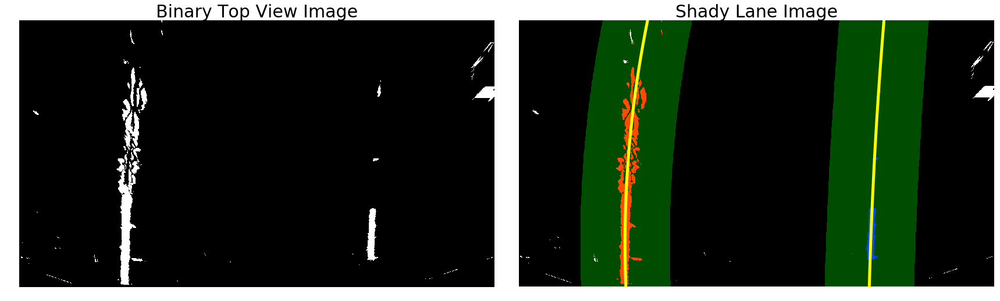

In [31]:
def shady_lanes(img, left_fit, right_fit, margin=120):
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    bird_eye, _ = top_view(img)
#     combined_binary_warped = pipeline_2(bird_eye, sobel_kernel=ksize, s_thresh=(150, 255), sx_thresh=(20, 100))
    combined_binary_warped = pipeline_5(bird_eye, sobel_kernel=ksize, r_thresh=(210, 255), h_thresh = (15, 80),
               l_thresh = (80, 255), s_thresh=(130, 255))
    # It's now much easier to find line pixels!
    nonzero = combined_binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
#     margin = 110
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
    left_fit[1]*nonzeroy + left_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
    right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, combined_binary_warped.shape[0]-1, combined_binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((combined_binary_warped, combined_binary_warped, combined_binary_warped))*255
#     out_img = np.uint8(np.dstack((combined_binary_warped, combined_binary_warped, combined_binary_warped))*255)
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                  ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                  ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    out_img = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    return out_img, ploty, left_fitx, right_fitx
    

ksize = 3

# for i, img in enumerate(test_images):
#     f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
#     img = mpimg.imread(img)
#     bird_eye, _ = top_view(img)
#     pip_5 = pipeline_5(bird_eye, sobel_kernel=ksize, r_thresh=(210, 255), h_thresh = (15, 80),
#                l_thresh = (80, 255), s_thresh=(130, 255))
#     f.tight_layout()
#     axs1.axis('off')
#     axs1.set_title('Binary Top View Image', fontsize=30)
#     axs1.imshow(pip_5, cmap='gray')
#     out_img, ploty, left_fitx, right_fitx = shady_lanes(img, left_fit, right_fit)
#     axs2.axis('off')
#     axs2.set_title('Shady Lane Image', fontsize=30)
#     axs2.imshow(out_img)
#     axs2.plot(left_fitx, ploty, color='yellow', linewidth=5)
#     axs2.plot(right_fitx, ploty, color='yellow', linewidth=5)
#     plt.xlim(0, 1280)
#     plt.ylim(720, 0)
#     plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)
    

f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
img = mpimg.imread('./test_images/test5.jpg')
bird_eye, _ = top_view(img)
pip_5 = pipeline_5(bird_eye, sobel_kernel=ksize, r_thresh=(210, 255), h_thresh = (15, 80),
           l_thresh = (80, 255), s_thresh=(130, 255))
f.tight_layout()
axs1.axis('off')
axs1.set_title('Binary Top View Image', fontsize=30)
axs1.imshow(pip_5, cmap='gray')
out_img, ploty, left_fitx, right_fitx = shady_lanes(img, left_fit, right_fit)
axs2.axis('off')
axs2.set_title('Shady Lane Image', fontsize=30)
axs2.imshow(out_img)
axs2.plot(left_fitx, ploty, color='yellow', linewidth=5)
axs2.plot(right_fitx, ploty, color='yellow', linewidth=5)
plt.xlim(0, 1280)
plt.ylim(720, 0)

plt.show() 

From searching in a margin around the previous line position, we can detect lane lines. This also gives the good result of the finding lanes, but I choose the sliding window technique. 

### Computing the Radius of Curvature and the Position of the Vehicle

![title](fy.png)

- We fit for f(y), rather than f(x) since the lane lines in the warped image are vertical.

![title](firstnsec.png)

#### Radius of Curvature:

![title](radius.png)

![title](radiusofcu.png)

The radius of curvature at a particular point is defiend as the radius of the approximating circle. The radius of both left and right lane line curvatures are calculated and averaged. The values of radius are corrected to derive a conversion from pixel space to world space by multiplying the polynomial coefficients, ym_per_pix and xm_per_pix which were chosen to be 30/image height, corresponding to 30 meteres per 720 pixels and 3.7/ pixel distance between lines corresponding to 3.7 meteres per 700 pixels respectively. The position of the vehicle is computed from the differece of the midpoint between the weo lane lines and the center of the image. If the result is positive then the car is located to the right from the center of lanes.  

In [32]:
# Calculation of Curvature
def cal_curvature_and_distanceofcenter(img, ploty, left_fitx, right_fitx, left_fit, right_fit, output):
#     warped, _ = top_view(img)
#     ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
    y_eval = np.max(ploty)
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    # Fit new polynomials to x,y in world space
    # leftx = left_fitx
    
#     fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)

    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    
    # Calculate the new radius of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    rad_curv = (left_curverad + right_curverad) / 2
#     rad_curv = ((1 + (2*fit_cr[0]*y_eval*ym_per_pix + fit_cr[1])**2)**1.5) / np.absolute(2*fit_cr[0])
   
    # Calculate distance of vehicle center
#     yMax=img.shape[0]*ym_per_pix
#     xMax=img.shape[1]*xm_per_pix
    yMax=img.shape[0]
    xMax=img.shape[1]
    center = xMax / 2
    
    lineLeft = left_fit[0]*yMax**2 + left_fit[1]*yMax + left_fit[2]
    lineRight = right_fit[0]*yMax**2 + right_fit[1]*yMax + right_fit[2]
#     centerfromlane = lineLeft + (lineRight - lineLeft)/2
    centerfromlane = (lineRight + lineLeft)/2
    difference = (centerfromlane - center) * xm_per_pix
    
    if difference > 0:
        result = '{:.2f} m right'.format(abs(difference))
    else:
        result = '{:.2f} m left'.format(abs(difference))

            
    # Draw info
    font = cv2.FONT_HERSHEY_SIMPLEX
    fontColor = (255, 255, 255)
    fontScale = 1.5
    cv2.putText(output, 'Radius of Curvature: {:.0f} m'.format(rad_curv), (30, 60), font, fontScale, fontColor, 3)
    cv2.putText(output, 'Vehicle is {} of Center'.format(result), (30, 120), font, fontScale, fontColor, 3)
    return rad_curv

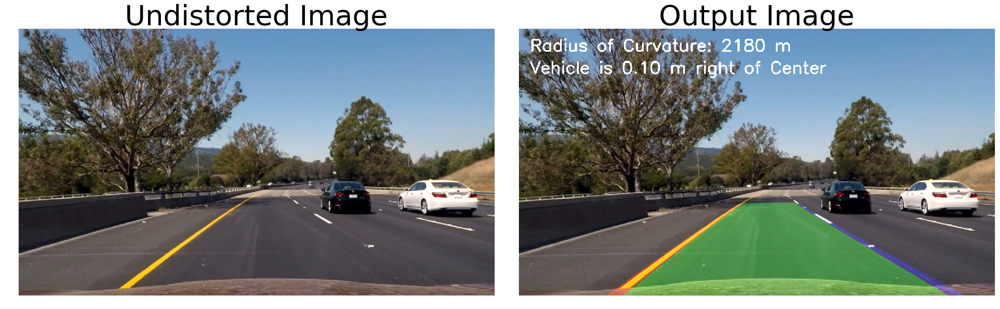

In [35]:
def drawing_line(img, left_fit, right_fit):
    und_img = undistort(img)
#     yMax = und_img.shape[0]
#     ploty = np.linspace(0, yMax - 1, yMax)
    
    # Create an image to draw the lines on
    bird_eye, Minv = top_view(img)
    warped = pipeline_5(bird_eye, sobel_kernel=ksize, r_thresh=(210, 255), h_thresh = (15, 80),
               l_thresh = (80, 255), s_thresh=(130, 255))
    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int_([pts_left], dtype=np.int32), False,(255,0,0),thickness = 30)
    cv2.polylines(color_warp, np.int_([pts_right], dtype=np.int32), False,(0,0,255),thickness = 30)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0]))
 
    # Combine the result with the original image
    result = cv2.addWeighted(und_img, 1, newwarp, 0.3, 0)
    

    
    return result

def drawingOnImage(img):

    out_img, ploty, left_fitx, right_fitx, left_fit, right_fit = sliding_windows(img)
    output = drawing_line(img, left_fit, right_fit)
    cal_curvature_and_distanceofcenter(img, ploty, left_fitx, right_fitx, left_fit, right_fit, output)
    
#     rad_curv = cal_curvature(ploty, left_fitx)
#     distance_center = dist_center_lanes(img, left_fit, right_fit)
    
    return output

ksize = 3

# for i, img in enumerate(test_images):
#     f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))
#     img = mpimg.imread(img)
#     und_img = undistort(img)
#     draw_lanes = drawingOnImage(img)
#     f.tight_layout()
#     axs1.axis('off')
#     axs1.set_title('Undistorted Image', fontsize=50)
#     axs1.imshow(und_img)
#     axs2.axis('off')
#     axs2.set_title('Output Image', fontsize=50)
#     axs2.imshow(draw_lanes)
#     plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)

f, (axs1, axs2) = plt.subplots(1, 2, figsize=(24, 9))

und_img = undistort(img)
draw_lanes = drawingOnImage(img)
f.tight_layout()
axs1.axis('off')
axs1.set_title('Undistorted Image', fontsize=50)
axs1.imshow(und_img)
axs2.axis('off')
axs2.set_title('Output Image', fontsize=50)
axs2.imshow(draw_lanes)
plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)
plt.show()

In [36]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        

In [37]:
# from IPython.display import HTML
output_video = ("output_videos/output_project_video1.mp4")
clip = VideoFileClip("project_video.mp4")
output_clip = clip.fl_image(drawingOnImage)
%time output_clip.write_videofile(output_video, audio=False)
# HTML("""
# <video width="960" height="540" controls>
#   <source src="{0}">
# </video>
# """.format(output_video))

[MoviePy] >>>> Building video output_videos/output_project_video1.mp4
[MoviePy] Writing video output_videos/output_project_video1.mp4


100%|██████████████████████████████████████████████████████████████████████▉| 1260/1261 [12:11<00:00,  1.70it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/output_project_video1.mp4 

Wall time: 12min 12s


### Discussion

I had spent a lot of time on the combined binary thresholding images to find out the best result of finding lane lines. The final pipeline seems to work well on project video. The process of he lane line detection however can get easily confused with obstacles such as the difference of the brightness by shadows acrossing on the road and with cars which get in the lane ahead of my car.  These are some examples that we need to consider to get a better result of the lane lines detection. To improve it, image augmentation, such as brightness normalization, would be needed to make it more robust.     

### Video Links

- [Project Video - YouTube Link](https://youtu.be/fdXParBbABA)
- [Challenge Video - YouTube Link](https://youtu.be/5bllQeuRVyk)
- [Track 1 - YouTube Link](https://youtu.be/CTcw2JEnEdI)